<a href="https://colab.research.google.com/github/DreamNengNeng/Class/blob/main/in_class_Practical_ML_%2B_Interpretability_Lecture_10_27_22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import altair as alt

alt.data_transformers.enable('default', max_rows=None)

DataTransformerRegistry.enable('default')

In [2]:
df = pd.read_csv("https://bit.ly/housing-csv")
df

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25.0,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18.0,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17.0,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18.0,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


In [3]:
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [4]:
housing_features = list(df.keys())
housing_features

alt.Chart(df).mark_bar().encode(
    alt.X(alt.repeat("column"), bin=True),
    alt.Y("count()")
).properties(
    width=200,
    height=200
).repeat(
    column=housing_features
)

alt.RepeatChart(...)

In [5]:
alt.Chart(df).mark_circle().encode(
    longitude='longitude',
    latitude='latitude',
    size='population',
    color='median_income',
    tooltip='population'
)

alt.Chart(...)

In [6]:
df.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

In [7]:
alt.Chart(df).mark_bar().encode(
    alt.X("total_bedrooms", bin=True, type="ordinal"),
    alt.Y("count()")
)

alt.Chart(...)

In [8]:
df = df.dropna(subset=["total_bedrooms"])

In [9]:
df.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
ocean_proximity       0
dtype: int64

In [10]:
corr_matrix = df.corr()
corr_matrix['median_house_value'].sort_values(ascending=False)

median_house_value    1.000000
median_income         0.688355
total_rooms           0.133294
housing_median_age    0.106432
households            0.064894
total_bedrooms        0.049686
population           -0.025300
longitude            -0.045398
latitude             -0.144638
Name: median_house_value, dtype: float64

In [11]:
features = ["median_house_value", "median_income", "total_rooms", "housing_median_age"]

alt.Chart(df).mark_circle(size=1).encode(
    alt.X(alt.repeat("column"), scale=alt.Scale(zero=False), type="quantitative"),
    alt.Y(alt.repeat("row"), scale=alt.Scale(zero=False), type="quantitative")
).properties(
    width=100,
    height=100
).repeat(
    row=features,
    column=features
)

alt.RepeatChart(...)

In [12]:
alt.Chart(df).mark_bar().encode(
    alt.X("median_income", scale=alt.Scale(zero=False)),
    alt.Y("count()")
)

alt.Chart(...)

In [13]:
from sklearn.preprocessing import StandardScaler

num_encoder = StandardScaler()

temp_df = df.copy()

temp_df["median_income_scaled"] = num_encoder.fit_transform(df[['median_income']])

In [14]:
alt.Chart(temp_df).mark_bar().encode(
    alt.X("median_income_scaled", scale=alt.Scale(zero=False)),
    alt.Y("count()")
)

alt.Chart(...)

In [16]:
df['ocean_proximity'].unique()

array(['NEAR BAY', '<1H OCEAN', 'INLAND', 'NEAR OCEAN', 'ISLAND'],
      dtype=object)

In [17]:
from sklearn.preprocessing import OneHotEncoder

cat_encoder = OneHotEncoder()
housing_cat_1hot = cat_encoder.fit_transform(df[['ocean_proximity']])
housing_cat_1hot.toarray()

cat_encoder.get_feature_names_out()

temp_df = pd.DataFrame(housing_cat_1hot.toarray(), columns = cat_encoder.get_feature_names_out())

temp_df.sum()

ocean_proximity_<1H OCEAN     9034.0
ocean_proximity_INLAND        6496.0
ocean_proximity_ISLAND           5.0
ocean_proximity_NEAR BAY      2270.0
ocean_proximity_NEAR OCEAN    2628.0
dtype: float64

In [18]:
from sklearn.model_selection import train_test_split

train_set, test_set = train_test_split(df, test_size=0.2)

housing = train_set.drop("median_house_value", axis=1)
housing_labels = train_set["median_house_value"].copy()

housing_test = test_set.drop("median_house_value", axis=1)
housing_test_labels = test_set["median_house_value"].copy()

#housing

In [19]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

housing_num = housing.drop("ocean_proximity", axis=1)

num_features = list(housing_num)
cat_features = ["ocean_proximity"]

full_pipeline = ColumnTransformer([
  ("num", StandardScaler(), num_features),
  ("cat", OneHotEncoder(), cat_features),              
])

housing_prepared = full_pipeline.fit_transform(housing)
housing_test_prepared = full_pipeline.fit_transform(housing_test)

housing_prepared

array([[ 0.72147026, -0.87852367,  1.86447203, ...,  0.        ,
         0.        ,  1.        ],
       [-1.41795273,  0.98570295,  1.86447203, ...,  0.        ,
         1.        ,  0.        ],
       [ 0.58682126, -0.82712895,  0.90861391, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [-1.41296573,  0.97168621,  0.5103397 , ...,  0.        ,
         1.        ,  0.        ],
       [ 0.73643126, -0.84114569,  0.58999454, ...,  0.        ,
         0.        ,  0.        ],
       [ 1.19523525, -1.37845411,  1.86447203, ...,  0.        ,
         0.        ,  1.        ]])

In [20]:
from sklearn.linear_model import LinearRegression

lin_reg = LinearRegression()
lin_reg.fit(housing_prepared, housing_labels)

LinearRegression()

In [21]:
some_data = housing.iloc[:50]
some_labels = housing_labels.iloc[:50]
some_data_prepared = full_pipeline.transform(some_data)

print("Predictions:", lin_reg.predict(some_data_prepared))
print("Labels:", list(some_labels))

Predictions: [300585.21317145 250718.53380692 349932.00912752  25049.41253665
 154079.14466465 229849.81903291 138043.76088425 368483.90910354
 221059.16326973 252340.65378522 272447.19143025 362333.36042694
 175216.39834349 107212.55570986  58544.91367659 175369.33631769
 162521.13983221 214620.58916407 204573.43312466 197902.70862191
  27923.17926246 219050.91096644 294958.93569192 138974.13750484
 320147.01983345  95187.42671413  53700.13212375 318703.63915009
 268714.02538444 373694.64455248 236768.11660047 120848.31702866
 124512.40741721 243315.39109149 147896.22438023 129118.22945639
 132200.81771891 147866.12346837 206088.06839757 226658.60882265
 177473.86676825 116551.13448527 162066.6166411  141668.1701039
 276510.6849874  215635.2292049  223616.45999032 353420.55098197
 347701.42237723 378911.23410929]
Labels: [381000.0, 275000.0, 479500.0, 71500.0, 216900.0, 229200.0, 126400.0, 442900.0, 173400.0, 216900.0, 434500.0, 500001.0, 360000.0, 105600.0, 70100.0, 135400.0, 153800.

In [23]:
some_object = {'Predictions': lin_reg.predict(some_data_prepared), "Labels": list(some_labels)}
some_df = pd.DataFrame(some_object)
some_df.head()

,Predictions,Labels
0,300585.213171,381000.0
1,250718.533807,275000.0
2,349932.009128,479500.0
3,25049.412537,71500.0
4,154079.144665,216900.0


In [24]:
alt.Chart(some_df).mark_point().encode(
    alt.X("Predictions"),
    alt.Y("Labels"),
    tooltip=["Predictions", "Labels"]

)

alt.Chart(...)

In [25]:
import numpy as np
from sklearn.metrics import mean_squared_error
housing_predictions = lin_reg.predict(housing_prepared)
lin_mse = mean_squared_error(housing_labels, housing_predictions)
lin_rmse = np.sqrt(lin_mse)
lin_rmse

68588.10821926696

In [26]:
import numpy as np
from sklearn.metrics import mean_squared_error
housing_predictions = lin_reg.predict(housing_test_prepared)
lin_mse = mean_squared_error(housing_test_labels, housing_predictions)
lin_rmse = np.sqrt(lin_mse)
lin_rmse

68902.2177824113

In [29]:
from sklearn.tree import DecisionTreeRegressor   # A regressor class.


tree_reg = DecisionTreeRegressor()
tree_reg.fit(housing_prepared, housing_labels)

DecisionTreeRegressor()

In [30]:
housing_predictions = tree_reg.predict(housing_test_prepared)
tree_mse = mean_squared_error(housing_test_labels, housing_predictions)
tree_rmse = np.sqrt(tree_mse)
tree_rmse

72643.11293081862

In [37]:
column_names = list(housing.columns) + list(full_pipeline.transformers_[1][1].get_feature_names_out())

In [38]:
column_names.remove("ocean_proximity")
column_names 

['longitude',
 'latitude',
 'housing_median_age',
 'total_rooms',
 'total_bedrooms',
 'population',
 'households',
 'median_income',
 'ocean_proximity_<1H OCEAN',
 'ocean_proximity_INLAND',
 'ocean_proximity_ISLAND',
 'ocean_proximity_NEAR BAY',
 'ocean_proximity_NEAR OCEAN']

In [35]:
from sklearn import tree
#print(tree.export_text(tree_reg, feature_names = column_names))

In [39]:
lin_reg.coef_

array([-53778.29796693, -54194.84512535,  13067.18788322, -13055.85214467,
        43141.7812792 , -41380.93312435,  15997.19960819,  74147.74383751,
       -20842.42500094, -60784.54314959, 122331.369178  , -24771.15709834,
       -15933.24392912])

In [40]:
feature_d = {'Importance Score': lin_reg.coef_, 'Features': list(column_names)}
feature_df = pd.DataFrame(feature_d)
feature_df

,Importance Score,Features
0,-53778.297967,longitude
1,-54194.845125,latitude
2,13067.187883,housing_median_age
3,-13055.852145,total_rooms
4,43141.781279,total_bedrooms
5,-41380.933124,population
6,15997.199608,households
7,74147.743838,median_income
8,-20842.425001,ocean_proximity_<1H OCEAN
9,-60784.543150,ocean_proximity_INLAND


In [42]:
alt.Chart(feature_df).mark_bar().encode(
    alt.X("Importance Score"),
    alt.Y("Features", sort='-x')
)

alt.Chart(...)

In [43]:
tree_reg.feature_importances_

array([1.24610456e-01, 1.09805738e-01, 4.83628818e-02, 2.39074096e-02,
       1.72816136e-02, 2.64563097e-02, 1.71633415e-02, 4.77270081e-01,
       5.03076206e-03, 1.44116256e-01, 2.47075938e-04, 1.64284726e-03,
       4.10522723e-03])

In [44]:
tree_feature_d = {'Importance Score': tree_reg.feature_importances_, 'Features': list(column_names)}
tree_feature_df = pd.DataFrame(tree_feature_d)
tree_feature_df

,Importance Score,Features
0,0.124610,longitude
1,0.109806,latitude
2,0.048363,housing_median_age
3,0.023907,total_rooms
4,0.017282,total_bedrooms
5,0.026456,population
6,0.017163,households
7,0.477270,median_income
8,0.005031,ocean_proximity_<1H OCEAN
9,0.144116,ocean_proximity_INLAND


In [45]:
alt.Chart(tree_feature_df).mark_bar().encode(
    alt.X("Importance Score"),
    alt.Y("Features", sort='-x')
)   #but decision tree does not give you it is positive or negative 
    #the types of property on the island 

alt.Chart(...)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_partial_dependence is deprecated; Function `plot_partial_dependence` is deprecated in 1.0 and will be removed in 1.2. Use PartialDependenceDisplay.from_estimator instead
  warnings.warn(msg, category=FutureWarning)


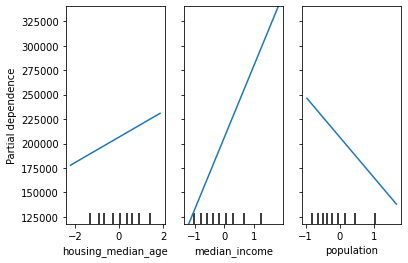

In [51]:
from sklearn.inspection import partial_dependence                  # partial_dependence to help you find the variables matter
from sklearn.inspection import plot_partial_dependence

housing_prepared_named = pd.DataFrame(housing_prepared, columns= column_names)
plot_partial_dependence(lin_reg, housing_prepared_named, ['housing_median_age', 'median_income', 'population'], n_jobs = 3, grid_resolution = 100)
                                                                                 # GPU: 3, run parallel 

*partial dependance is to keep all the other variables same , just look at one feature at a time ⚾ *

In [49]:
# as housing median age increases, the importance goes up

In [53]:
!pip install lime
from lime import lime_tabular

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [54]:
explainer = lime_tabular.LimeTabularExplainer(training_data = np.array(housing_prepared), feature_names = list(column_names), mode = 'regression')

In [56]:
housing_test_prepared[143]   # let us check on the 143 house 

array([ 0.81470585, -0.92213352, -0.06225259, -0.68104366, -0.2736802 ,
       -0.53901595, -0.20113956, -1.516941  ,  1.        ,  0.        ,
        0.        ,  0.        ,  0.        ])

In [57]:
exp = explainer.explain_instance(data_row=housing_test_prepared[143], predict_fn = lin_reg.predict)

exp.show_in_notebook(show_all=False)

In [60]:
housing_test.iloc[143]

longitude               -117.92
latitude                  33.65
housing_median_age         28.0
total_rooms              1087.0
total_bedrooms            423.0
population                807.0
households                425.0
median_income            0.9702
ocean_proximity       <1H OCEAN
Name: 10823, dtype: object

In [61]:
!pip install shap
import shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 569 kB 5.3 MB/s 


In [63]:
exp = shap.TreeExplainer(tree_reg)
shap_values = exp.shap_values(housing_test_prepared)

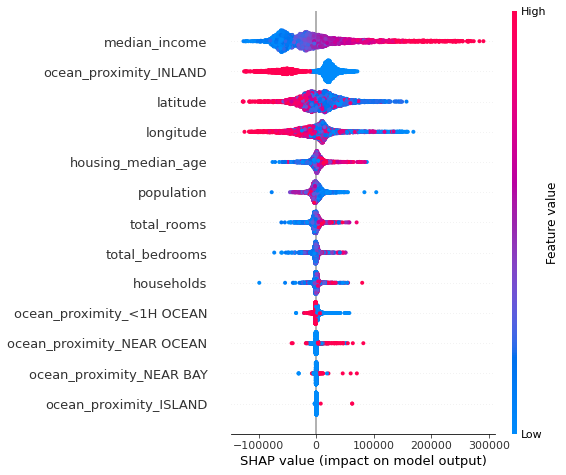

In [64]:
shap.summary_plot(shap_values, housing_test_prepared, feature_names = column_names)

In [65]:
shap.initjs()
shap.force_plot(exp.expected_value, shap_values[550], features = housing_test_prepared[550, :], feature_names = column_names)

Dimensionality Reduction

In [67]:
from sklearn.manifold import TSNE
tsne = TSNE(2)
tsne_result = tsne.fit_transform(housing_prepared)

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.


In [68]:
tsne_result_df = pd.DataFrame({'tsne_1': tsne_result[:,0], 'tsne_2': tsne_result[:,1], 'label': housing_labels})

In [ ]:
merged = housing.merge(tsne_result_df, df, )

In [ ]:
alt.Chart()